# Annotate individual sources for immune populations

### Import required modules

In [1]:
import bbknn
import anndata
import numpy as np
import scanpy as sc
import pandas as pd

/opt/conda/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 260, color_map = 'RdPu', dpi_save = 260, vector_friendly = True, format = 'svg')

scanpy==1.4.4.post1 anndata==0.7rc2 umap==0.3.10 numpy==1.17.2 scipy==1.3.1 pandas==0.23.4 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [3]:
def regress_pca(pca, batch):
    regressors = np.zeros(pca.shape, dtype = 'float64')
    regressed = np.zeros(pca.shape, dtype = 'float64')
    for category in np.unique(batch):
        mask = (category == batch)
        regressors[mask,:] = np.mean(pca[mask,:],axis = 0)
    for i in range(pca.shape[1]):
        t = np.c_[np.ones(regressors[:,i].shape),regressors[:,i]]
        b = np.dot(np.dot(np.linalg.inv(np.dot(t.T,t)),t.T),pca[:,i])
        regressed[:,i] = pca[:,i] - b[0] - b[1] * t[:,1]
    return regressed

### Read in data

In [4]:
heart_raw = sc.read('/home/jovyan/cartal_experiments/global/hca_heart_global_ctl200422.h5ad')
heart = anndata.AnnData(X = heart_raw.raw.X, var = heart_raw.raw.var, obs = heart_raw.obs, obsm = heart_raw.obsm)
heart

AnnData object with n_obs × n_vars = 486134 × 33538 
    obs: 'NRP', 'age_group', 'batch', 'cell_source', 'cell_type', 'donor', 'gender', 'leiden', 'leiden_annotated', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    obsm: 'X_pca', 'X_umap'

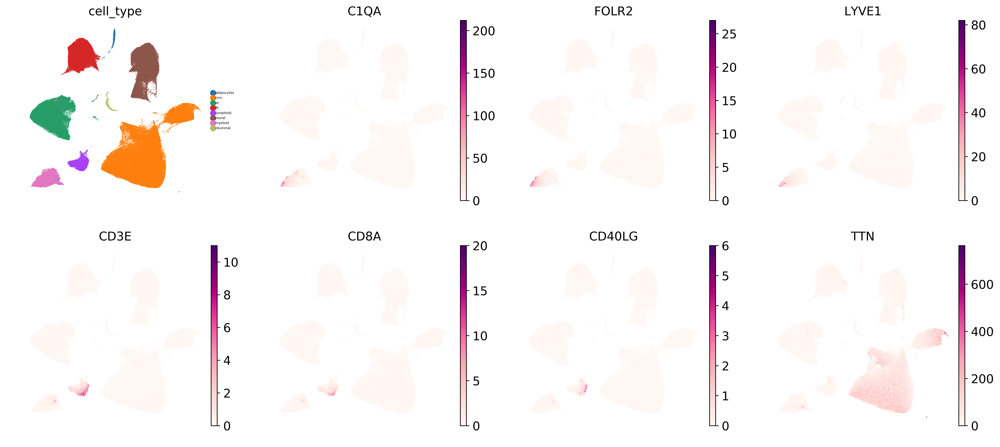

In [5]:
sc.pl.umap(heart, color = ['cell_type', 'C1QA', 'FOLR2', 'LYVE1', 'CD3E', 'CD8A', 'CD40LG', 'TTN'], color_map = 'RdPu', frameon = False, legend_fontsize = 4, size = 1, use_raw = False)

### Subset immune populations

In [6]:
heart.obs['cell_type'].cat.categories

Index(['adipocytes', 'cmc', 'ec', 'fb', 'lymphoid', 'mural', 'myeloid',
       'neuronal'],
      dtype='object')

In [7]:
heart_immune = heart[heart.obs['cell_type'].isin(['lymphoid', 'myeloid'])]
heart_immune

View of AnnData object with n_obs × n_vars = 48523 × 33538 
    obs: 'NRP', 'age_group', 'batch', 'cell_source', 'cell_type', 'donor', 'gender', 'leiden', 'leiden_annotated', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    uns: 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'

/opt/conda/lib/python3.7/site-packages/anndata/_core/anndata.py:1118: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning,


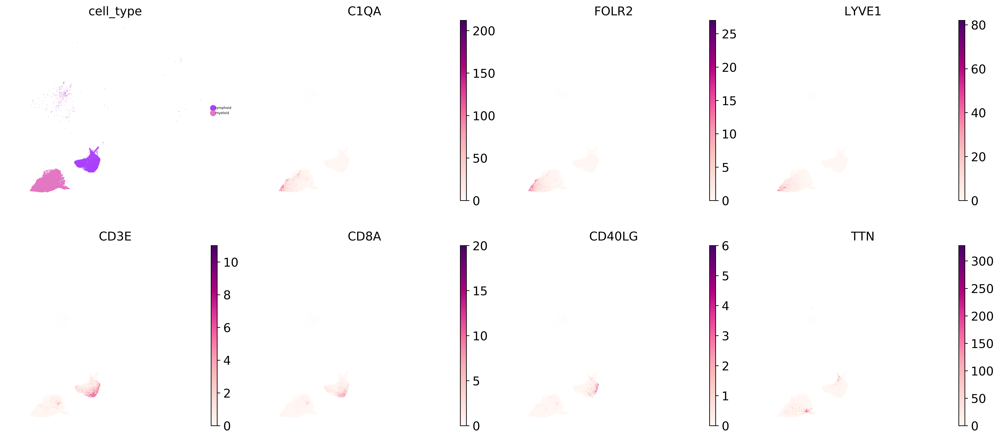

In [8]:
sc.pl.umap(heart_immune, color = ['cell_type', 'C1QA', 'FOLR2', 'LYVE1', 'CD3E', 'CD8A', 'CD40LG', 'TTN'], color_map = 'RdPu', frameon = False, legend_fontsize = 4, size = 1, use_raw = False)

In [ ]:
heart_immune.write('/home/jovyan/cartal_experiments/subpopulations/4-immune/hca_heart_immune_ctl200518_RAW.h5ad')

In [9]:
heart_immune.X[:5,:5].todense()

matrix([[0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.]], dtype=float32)

In [15]:
heart_immune.obs['cell_type'].cat.categories

Index(['lymphoid', 'myeloid'], dtype='object')

In [16]:
heart_immune.obs['cell_source'].cat.categories

Index(['Harvard-Nuclei', 'Sanger-CD45', 'Sanger-Cells', 'Sanger-Nuclei'], dtype='object')

### Split immune cells by sources

In [18]:
immune_cells = heart_immune[heart_immune.obs['cell_source'].isin(['Sanger-Cells'])]
immune_cd45 = heart_immune[heart_immune.obs['cell_source'].isin(['Sanger-CD45'])]
immune_sanger = heart_immune[heart_immune.obs['cell_source'].isin(['Sanger-Nuclei'])]
immune_harvard = heart_immune[heart_immune.obs['cell_source'].isin(['Harvard-Nuclei'])]

In [19]:
immune_cells.X[:5,:5].todense()

matrix([[0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0.]], dtype=float32)

In [21]:
num = np.sum(np.expm1(immune_cells.X[0,:]))
output = "{:.7f}".format(num)
print(output)

14130250996457790242816.0000000


/opt/conda/lib/python3.7/site-packages/anndata/_core/anndata.py:1118: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning,


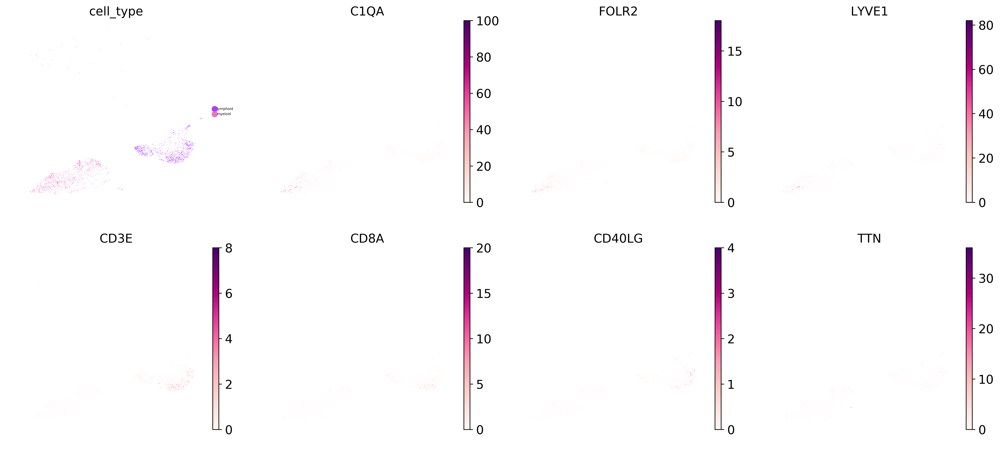

In [22]:
sc.pl.umap(immune_cells, color = ['cell_type', 'C1QA', 'FOLR2', 'LYVE1', 'CD3E', 'CD8A', 'CD40LG', 'TTN'], color_map = 'RdPu', frameon = False, legend_fontsize = 4, size = 1, use_raw = False)

# Annotate each source

- Cells

In [23]:
#immune_cells.X.astype(np.float64)
cells_bckp = immune_cells.copy()
sc.pp.normalize_per_cell(immune_cells, counts_per_cell_after = 1e4)
sc.pp.log1p(immune_cells)
immune_cells.raw = immune_cells

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [24]:
sc.pp.highly_variable_genes(immune_cells, flavor = 'seurat')
cells_hvg = immune_cells[:, immune_cells.var['highly_variable']]
sc.pp.scale(cells_hvg, max_value = 10)
cells_hvg.shape

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:869: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


(2313, 3778)

In [25]:
sc.tl.pca(cells_hvg, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(cells_hvg, random_state = 1712)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)


In [26]:
cells_hvg.obsm['X_pca_original'] = cells_hvg.obsm['X_pca'].copy()
cells_hvg.obsm['X_pca'] = regress_pca(cells_hvg.obsm['X_pca'], cells_hvg.obs['donor'])

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


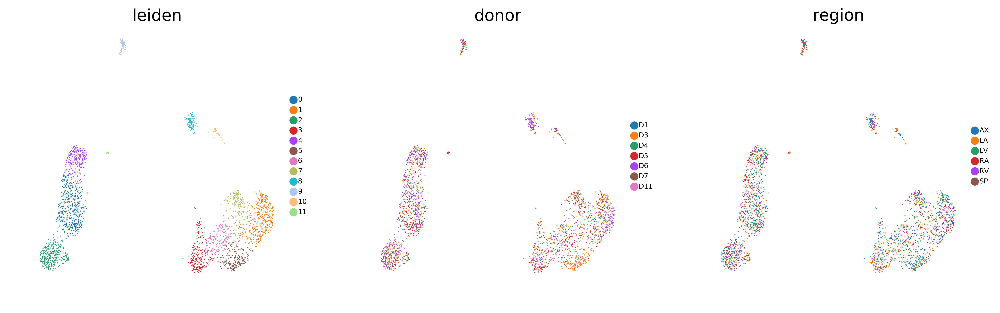

In [27]:
cells_bbknn = bbknn.bbknn(cells_hvg, neighbors_within_batch = 2, batch_key = 'donor', n_trees = 30, copy = True)
sc.tl.umap(cells_bbknn, min_dist = 0.2, spread = 1, random_state = 1712)
sc.tl.leiden(cells_bbknn, resolution = 1, random_state = 1786)
sc.pl.umap(cells_bbknn, color = ['leiden', 'donor', 'region'], size = 3, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

In [28]:
sc.tl.rank_genes_groups(cells_bbknn, 'leiden', method = 'wilcoxon', n_genes = 200, use_raw = True)
result = cells_bbknn.uns['rank_genes_groups']
groups = result['names'].dtype.names
markers_cells = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
markers_cells.head(10)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:06)


,0_n,0_p,0_l,1_n,1_p,1_l,2_n,2_p,2_l,3_n,...,8_l,9_n,9_p,9_l,10_n,10_p,10_l,11_n,11_p,11_l
0,CCL5,5.887097e-163,5.095887,S100A8,8.508130e-157,6.566433,PRF1,3.824959e-140,5.457963,C1QB,...,6.966499,CD74,9.348324e-24,3.358916,NDUFA4L2,1.236242e-18,6.412963,TPSAB1,0.000008,36.521320
1,IL32,5.635715e-147,4.475788,S100A9,2.987704e-154,5.880692,NKG7,7.726971e-138,5.226751,C1QA,...,7.073250,IGKC,1.876341e-22,9.576197,RGS5,1.815362e-18,5.917520,TPSB2,0.000008,17.057783
2,CD3D,8.073385e-147,4.975635,NAMPT,7.374192e-120,3.931435,GNLY,6.195460e-126,6.218367,RNASE1,...,5.201447,RPS8,6.475887e-20,1.505753,IGFBP7,4.245467e-17,5.120255,RGS1,0.000403,4.571558
3,GZMA,7.703387e-105,3.719929,S100A12,1.521041e-115,6.832847,CD247,2.044658e-125,5.132956,C1QC,...,6.187373,RPL13A,4.584281e-19,1.475932,SPARCL1,6.077950e-17,5.613891,CD69,0.000403,4.707684
4,RPS27,1.977733e-104,1.461825,SRGN,5.040895e-109,2.203772,KLRD1,1.652018e-124,4.981725,PLTP,...,5.027666,RPL21,7.163788e-18,1.337892,SPARC,1.094589e-14,5.142625,LAPTM4A,0.000543,3.895851
5,NKG7,4.294601e-91,3.788694,STXBP2,7.398175e-93,3.402857,GZMB,3.056192e-119,5.414619,LYVE1,...,3.749197,RPS23,7.599800e-18,1.358666,ADIRF,5.092810e-14,5.253571,UBB,0.000850,2.565385
6,RPS29,8.278584e-91,1.355649,NEAT1,7.141408e-92,2.370057,CD7,1.679601e-112,4.658026,F13A1,...,6.100852,RPS27A,4.072389e-17,1.246600,MFGE8,1.669487e-13,5.652267,RPL34,0.004499,1.707677
7,TRAC,2.001330e-88,4.041485,LYZ,2.644555e-85,3.848529,CTSW,9.673244e-111,4.544940,SELENOP,...,6.466413,RPS18,1.886500e-16,1.343603,MYL9,7.700875e-13,4.424836,MS4A2,0.006617,32.867176
8,GZMH,2.494130e-85,4.219218,VCAN,5.780696e-83,4.225841,KLRF1,2.539272e-101,5.495877,DAB2,...,5.279786,RPL18A,4.184922e-16,1.231839,CALD1,8.773587e-12,4.949366,RGS13,0.006617,9.683027
9,RPL23A,1.398364e-83,1.304470,MNDA,6.536276e-83,3.319128,SPON2,3.568023e-100,5.538513,CD163,...,5.806823,CD79A,1.117168e-15,10.553966,PLAC9,2.620193e-11,5.125857,HSP90AB1,0.024448,2.211293


In [ ]:
markers_cells.to_csv('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_immune_cells_wilcox_ctl200518.tsv', sep = '\t', index = False)

In [29]:
cells_bbknn.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11'], dtype='object')

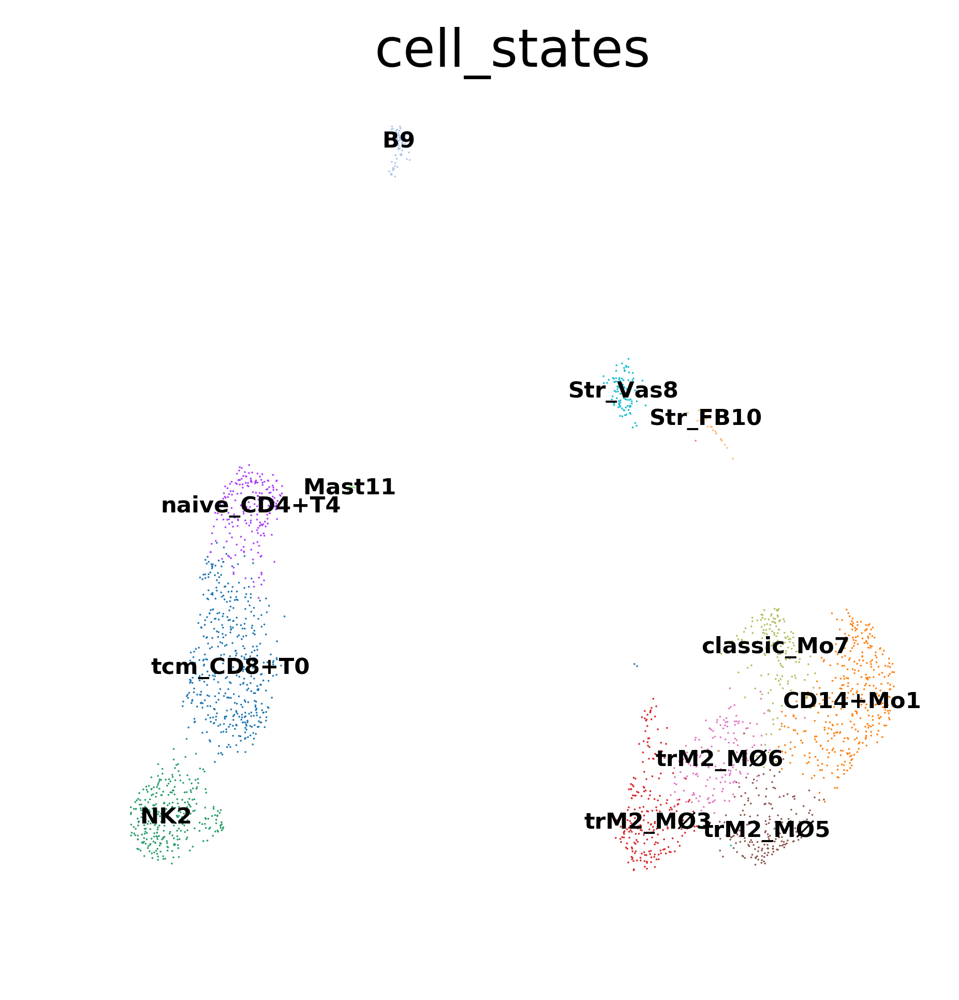

In [30]:
cells_bbknn.obs['cell_states'] = cells_bbknn.obs['leiden']
cells_bbknn.obs['cell_states'].cat.categories = ['tcm_CD8+T0', 'CD14+Mo1', 'NK2', 'trM2_MØ3', 'naive_CD4+T4', 'trM2_MØ5', 'trM2_MØ6', 'classic_Mo7', 'Str_Vas8', 'B9', 'Str_FB10', 'Mast11']
sc.pl.umap(cells_bbknn, color = ['cell_states'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False)

In [31]:
cells_bbknn_raw = anndata.AnnData(X = cells_bckp.X , obs = cells_bbknn.obs, var = cells_bckp.var, obsm = cells_bbknn.obsm)
cells_bbknn_raw

AnnData object with n_obs × n_vars = 2313 × 33538 
    obs: 'NRP', 'age_group', 'batch', 'cell_source', 'cell_type', 'donor', 'gender', 'leiden', 'leiden_annotated', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'region', 'sample', 'scrublet_score', 'source', 'type', 'version', 'cell_states'
    var: 'gene_ids-Harvard-Nuclei', 'feature_types-Harvard-Nuclei', 'gene_ids-Sanger-Nuclei', 'feature_types-Sanger-Nuclei', 'gene_ids-Sanger-Cells', 'feature_types-Sanger-Cells', 'gene_ids-Sanger-CD45', 'feature_types-Sanger-CD45'
    obsm: 'X_pca', 'X_umap', 'X_pca_original'

In [32]:
cells_bbknn_raw.obs['cell_states'].cat.categories

Index(['tcm_CD8+T0', 'CD14+Mo1', 'NK2', 'trM2_MØ3', 'naive_CD4+T4', 'trM2_MØ5',
       'trM2_MØ6', 'classic_Mo7', 'Str_Vas8', 'B9', 'Str_FB10', 'Mast11'],
      dtype='object')

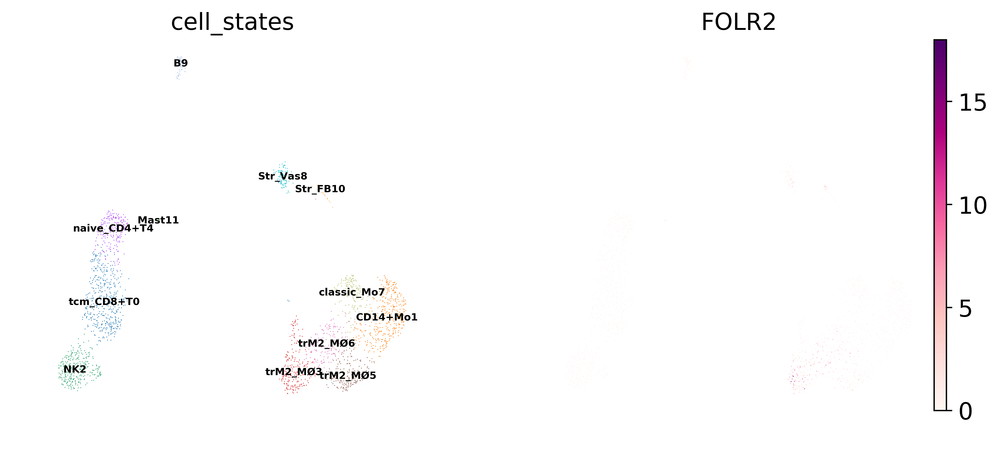

In [35]:
sc.pl.umap(cells_bbknn_raw, color = ['cell_states', 'FOLR2'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False, use_raw = False)

In [36]:
cells_bbknn_raw.write('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_sanger_immmune_cells_annotated_ctl200518.h5ad')

- CD45+

In [37]:
#immune_cd45.X.astype(np.float64)
cd45_bckp = immune_cd45.copy()
sc.pp.normalize_per_cell(immune_cd45, counts_per_cell_after = 1e4)
sc.pp.log1p(immune_cd45)
immune_cd45.raw = immune_cd45

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:01): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [38]:
sc.pp.highly_variable_genes(immune_cd45, flavor = 'seurat')
cd45_hvg = immune_cd45[:, immune_cd45.var['highly_variable']]
sc.pp.scale(cd45_hvg, max_value = 10)
cd45_hvg.shape

extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:869: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


(22118, 2530)

In [39]:
sc.tl.pca(cd45_hvg, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(cd45_hvg, random_state = 1712)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 50


/opt/conda/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../opt/conda/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  self.func_ir.loc))
/opt/conda/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../opt/conda/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:07)


In [40]:
cd45_hvg.obsm['X_pca_original'] = cd45_hvg.obsm['X_pca'].copy()
cd45_hvg.obsm['X_pca'] = regress_pca(cd45_hvg.obsm['X_pca'], cd45_hvg.obs['donor'])

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:18)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:07)


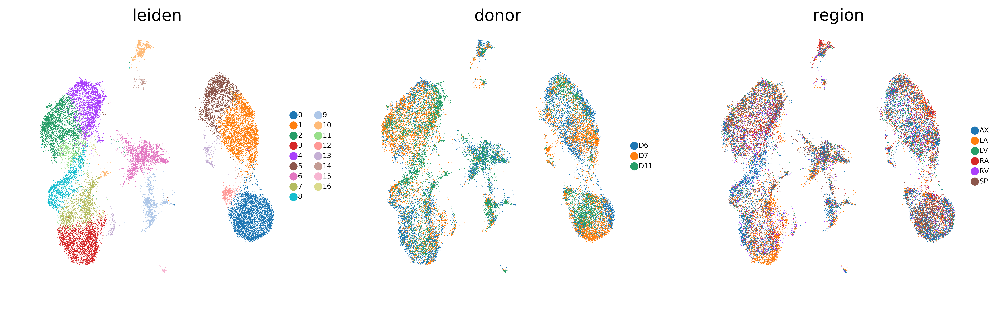

In [41]:
cd45_bbknn = bbknn.bbknn(cd45_hvg, neighbors_within_batch = 3, batch_key = 'donor', n_trees = 30, copy = True)
sc.tl.umap(cd45_bbknn, min_dist = 0.2, spread = 1, random_state = 1712)
sc.tl.leiden(cd45_bbknn, resolution = 1, random_state = 1786)
sc.pl.umap(cd45_bbknn, color = ['leiden', 'donor', 'region'], size = 2, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

In [42]:
sc.tl.rank_genes_groups(cd45_bbknn, 'leiden', method = 'wilcoxon', n_genes = 200, use_raw = True)
result = cd45_bbknn.uns['rank_genes_groups']
groups = result['names'].dtype.names
markers_cd45 = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
markers_cd45.head(10)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:01:04)


,0_n,0_p,0_l,1_n,1_p,1_l,2_n,2_p,2_l,3_n,...,13_l,14_n,14_p,14_l,15_n,15_p,15_l,16_n,16_p,16_l
0,GNLY,0.0,5.854942,CD3D,0.0,4.779542,LST1,0.0,3.725506,RNASE1,...,4.835241,JCHAIN,2.724242e-43,9.890973,TPSAB1,4.671152e-48,14.292463,MYL2,2.155206e-41,5.722758
1,NKG7,0.0,4.975322,IL32,0.0,3.849840,FCN1,0.0,3.872587,C1QA,...,3.166209,MZB1,9.762731e-42,9.095558,TPSB2,7.162412e-45,13.963752,TNNC1,8.631171e-40,5.360001
2,PRF1,0.0,5.190325,CCL5,0.0,4.052244,COTL1,0.0,2.838104,C1QB,...,3.194043,IGKC,4.901450e-39,8.315857,LAPTM4A,4.040983e-30,3.293088,TNNI3,9.901746e-36,5.017984
3,GZMB,0.0,5.353698,TRAC,0.0,4.224249,CTSS,0.0,2.854020,C1QC,...,7.404487,SSR4,1.072538e-20,2.409855,HPGDS,3.124246e-28,5.912350,TPM1,6.110201e-34,4.425080
4,CTSW,0.0,4.531224,RPS27,0.0,1.390673,SERPINA1,0.0,3.280070,SELENOP,...,2.662936,IGHM,6.334567e-18,5.898051,RGS13,6.425246e-28,9.665192,MYL3,4.419121e-33,5.945223
5,CST7,0.0,3.991085,B2M,0.0,0.902778,SAT1,0.0,2.328727,LYVE1,...,1.100808,HSP90B1,5.435961e-14,1.982900,MS4A2,2.234680e-26,13.817938,TCAP,8.766227e-30,4.699795
6,KLRD1,0.0,4.395003,TRBC2,0.0,3.389040,AIF1,0.0,2.993362,F13A1,...,2.739038,IGHG3,1.300503e-13,8.485625,FTH1,1.113106e-25,2.009027,ACTC1,6.271166e-28,4.735236
7,SPON2,0.0,5.014066,CD3E,0.0,3.776938,FTL,0.0,2.164282,PLTP,...,2.453137,IGHG1,1.886971e-13,7.838561,CD69,5.331029e-25,3.423043,TNNT2,1.414634e-25,4.625371
8,CD7,0.0,4.012694,GZMH,0.0,3.429096,TIMP1,0.0,2.706137,FOLR2,...,7.607081,FKBP11,2.814072e-13,2.772169,CPA3,7.980418e-25,13.031164,CRYAB,1.711003e-25,4.439308
9,CD247,0.0,4.423066,GZMA,0.0,2.905618,PSAP,0.0,2.299977,CD14,...,1.909261,SEC11C,6.774192e-13,2.713344,GATA2,2.499916e-23,7.228139,PLN,2.696689e-25,4.858844


In [43]:
markers_cd45.to_csv('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_immune_cd45_wilcox_ctl200518.tsv', sep = '\t', index = False)

In [44]:
cd45_bbknn.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16'],
      dtype='object')

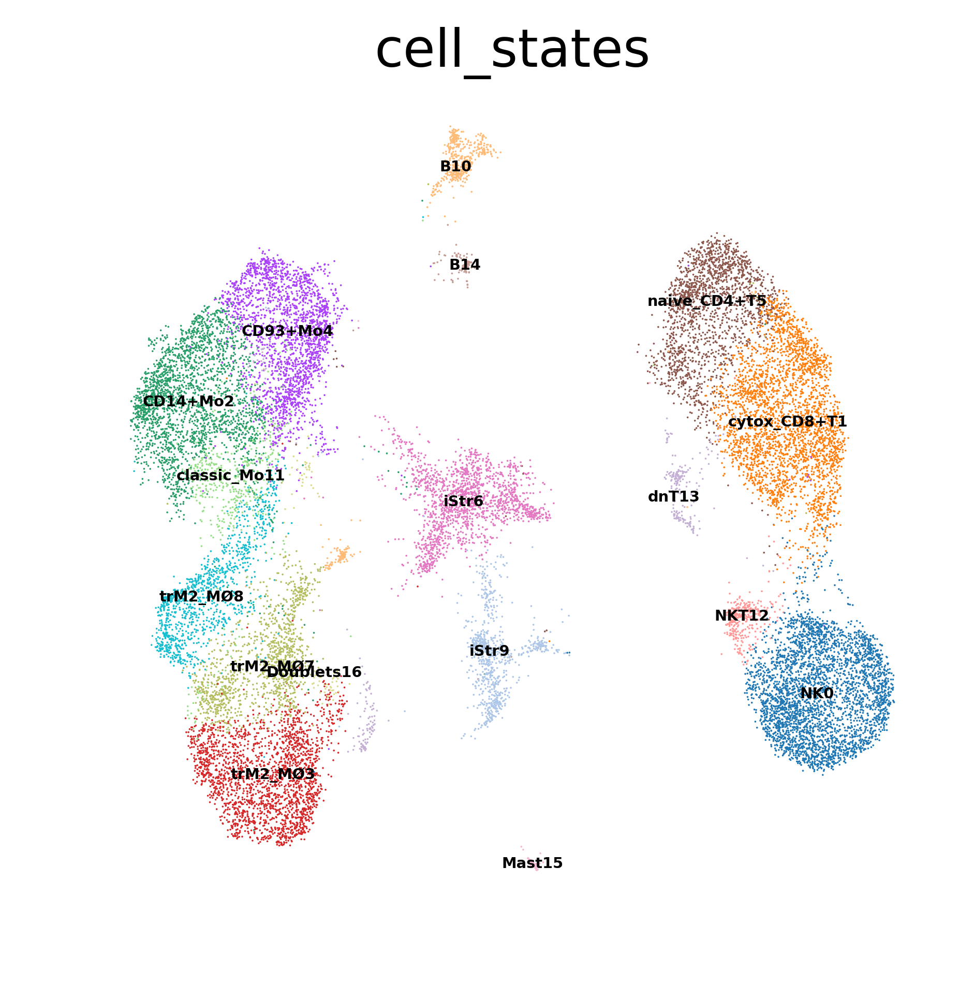

In [48]:
cd45_bbknn.obs['cell_states'] = cd45_bbknn.obs['leiden']
cd45_bbknn.obs['cell_states'].cat.categories = ['NK0', 'cytox_CD8+T1', 'CD14+Mo2', 'trM2_MØ3', 'CD93+Mo4', 'naive_CD4+T5', 'iStr6', 'trM2_MØ7', 'trM2_MØ8', 'iStr9', 'B10', 'classic_Mo11', 'NKT12',
       'dnT13', 'B14', 'Mast15', 'Doublets16']
sc.pl.umap(cd45_bbknn, color = ['cell_states'], size = 1, legend_fontsize = 4, legend_loc = 'on data', frameon = False)

In [49]:
cd45_bbknn_raw = anndata.AnnData(X = cd45_bckp.X , obs = cd45_bbknn.obs, var = cd45_bckp.var, obsm = cd45_bbknn.obsm)
cd45_bbknn_raw.write('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_sanger_immmune_cd45_annotated_ctl200518.h5ad')

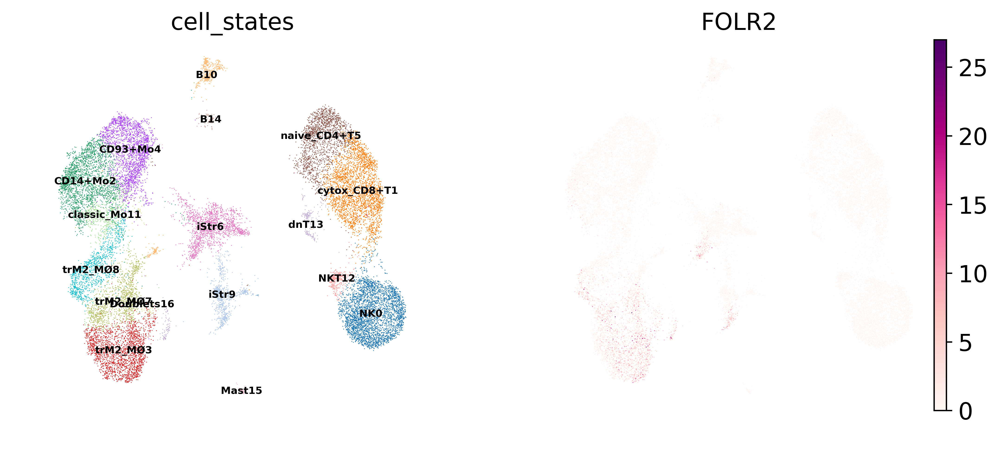

In [50]:
sc.pl.umap(cd45_bbknn_raw, color = ['cell_states', 'FOLR2'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False, use_raw = False)

In [51]:
cd45_bbknn.obs['cell_states'].cat.categories

Index(['NK0', 'cytox_CD8+T1', 'CD14+Mo2', 'trM2_MØ3', 'CD93+Mo4',
       'naive_CD4+T5', 'iStr6', 'trM2_MØ7', 'trM2_MØ8', 'iStr9', 'B10',
       'classic_Mo11', 'NKT12', 'dnT13', 'B14', 'Mast15', 'Doublets16'],
      dtype='object')

- Sanger-Nuclei

In [52]:
sanger_bckp = immune_sanger.copy()
sc.pp.normalize_per_cell(immune_sanger, counts_per_cell_after = 1e4)
sc.pp.log1p(immune_sanger)
immune_sanger.raw = immune_sanger

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [53]:
sc.pp.highly_variable_genes(immune_sanger, flavor = 'seurat')
sanger_hvg = immune_sanger[:, immune_sanger.var['highly_variable']]
sc.pp.scale(sanger_hvg, max_value = 10)
sanger_hvg.shape

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:869: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


(10403, 2499)

In [54]:
sc.tl.pca(sanger_hvg, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(sanger_hvg, random_state = 1712)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:03)
computing neighbors
    using 'X_pca' with n_pcs = 50


/opt/conda/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../opt/conda/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:03)


In [55]:
sanger_hvg.obsm['X_pca_original'] = sanger_hvg.obsm['X_pca'].copy()
sanger_hvg.obsm['X_pca'] = regress_pca(sanger_hvg.obsm['X_pca'], sanger_hvg.obs['donor'])

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:12)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:06)


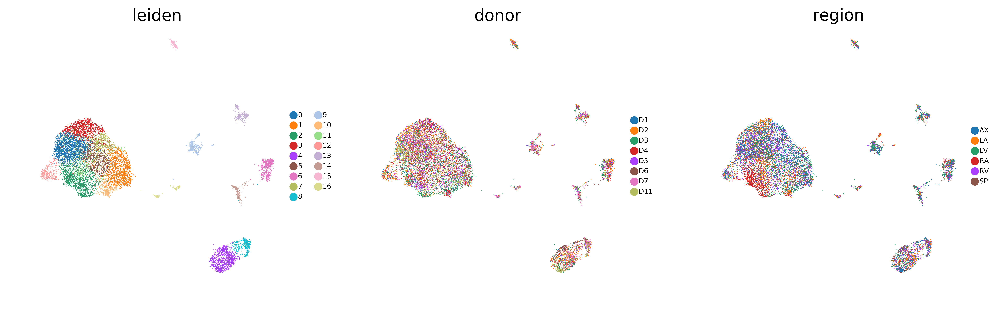

In [56]:
sanger_bbknn = bbknn.bbknn(sanger_hvg, neighbors_within_batch = 3, batch_key = 'donor', n_trees = 30, copy = True)
sc.tl.umap(sanger_bbknn, min_dist = 0.2, spread = 1, random_state = 1712)
sc.tl.leiden(sanger_bbknn, resolution = 1.3, random_state = 1786)
sc.pl.umap(sanger_bbknn, color = ['leiden', 'donor', 'region'], size = 2, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

In [60]:
sc.tl.rank_genes_groups(sanger_bbknn, 'leiden', method = 'wilcoxon', n_genes = 200, use_raw = True)
result = sanger_bbknn.uns['rank_genes_groups']
groups = result['names'].dtype.names
markers_sanger = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
markers_sanger.head(10)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:25)


,0_n,0_p,0_l,1_n,1_p,1_l,2_n,2_p,2_l,3_n,...,13_l,14_n,14_p,14_l,15_n,15_p,15_l,16_n,16_p,16_l
0,F13A1,0.000000e+00,3.089622,CD74,1.557244e-164,3.067864,NAMPT,1.227071e-137,3.033140,RBPJ,...,6.914989,LDB2,3.670085e-66,6.293626,NTM,1.305483e-101,8.627734,CCSER1,3.675165e-17,4.323124
1,SLC9A9,9.972877e-139,1.796260,HLA-DRA,1.927126e-101,3.603756,DOCK4,7.179409e-105,2.095320,MAMDC2,...,4.937832,PTPRM,1.080240e-41,3.143744,SLC24A3,3.630953e-79,7.092119,WDFY4,1.511308e-10,3.694137
2,RBPJ,3.841636e-118,1.865288,HLA-DRB1,7.986700e-89,2.966157,SLC11A1,2.052530e-72,2.322151,FRMD4B,...,6.127309,MECOM,5.832290e-39,4.750241,SMYD3,1.057459e-49,3.631817,RABGAP1L,5.875368e-10,1.876966
3,RBM47,5.347462e-100,1.550196,MT-CO1,4.123229e-67,1.551484,EPB41L3,1.289122e-65,1.776673,PDE4D,...,4.460918,VWF,1.144021e-32,5.510688,KIT,2.041380e-46,8.447620,CD74,9.235985e-09,2.223065
4,STAB1,5.347462e-100,1.754725,CST3,7.758181e-64,2.211880,CTSB,2.888543e-57,1.628532,F13A1,...,0.680706,ID1,7.354372e-31,5.009484,MEIS2,3.629620e-41,4.992088,CADM1,4.575561e-08,4.312623
5,FRMD4B,1.252969e-98,1.518449,PLXDC2,5.308088e-63,1.496373,RNF149,1.189535e-52,1.407416,COLEC12,...,4.805138,EMCN,1.745643e-28,5.960923,TNIK,3.629620e-41,4.407343,IRF8,1.264673e-07,4.142227
6,FGF13,1.368067e-92,2.319308,CD14,8.368106e-56,1.990338,SLC2A3,2.070168e-52,2.064574,MS4A6A,...,5.377820,PLCB1,3.246229e-27,3.446621,HDC,3.616407e-40,8.225603,ETV6,1.701575e-07,1.682261
7,NEAT1,8.997057e-84,0.959183,MT-CO3,2.835117e-49,1.519644,SAT1,1.235625e-50,1.455740,NAV2,...,4.169070,EGFL7,3.246229e-27,4.650263,TPSB2,3.651251e-38,8.468833,CLNK,1.370004e-06,4.850344
8,COLEC12,2.704482e-81,1.664675,ACTB,5.673378e-47,1.571204,ARHGAP26,1.009982e-46,1.206613,SLC9A9,...,6.225664,PITPNC1,1.290961e-26,2.663368,FER,1.408227e-33,3.109533,SEL1L3,1.565585e-06,3.986815
9,FMN1,1.794538e-79,1.511066,HLA-DRB5,1.475404e-45,3.206783,MARCO,2.722034e-46,2.580625,LSAMP,...,5.855648,FLT1,6.735277e-26,4.762700,MS4A2,1.070034e-31,8.168935,IGKC,9.902641e-06,7.629842


In [61]:
markers_sanger.to_csv('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_immune_sanger-nuclei_wilcox_ctl200518.tsv', sep = '\t', index = False)

In [62]:
sanger_bbknn.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16'],
      dtype='object')

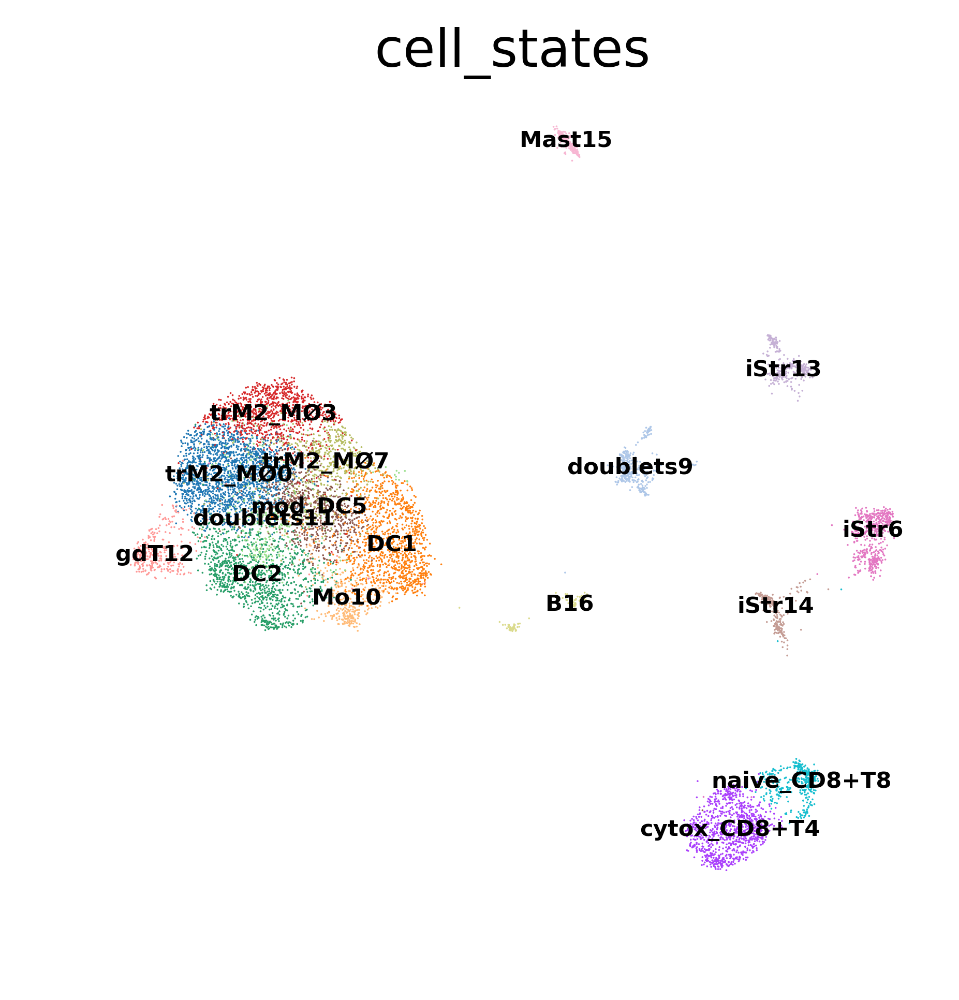

In [66]:
sanger_bbknn.obs['cell_states'] = sanger_bbknn.obs['leiden']
sanger_bbknn.obs['cell_states'].cat.categories = ['trM2_MØ0', 'DC1', 'DC2', 'trM2_MØ3', 'cytox_CD8+T4', 'mod_DC5', 'iStr6', 'trM2_MØ7', 'naive_CD8+T8', 'doublets9', 'Mo10', 'doublets11', 'gdT12',
       'iStr13', 'iStr14', 'Mast15', 'B16']
sc.pl.umap(sanger_bbknn, color = ['cell_states'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False)

In [67]:
sanger_bbknn_raw = anndata.AnnData(X = sanger_bckp.X , obs = sanger_bbknn.obs, var = sanger_bckp.var, obsm = sanger_bbknn.obsm)
sanger_bbknn_raw.write('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_sanger_immmune_nuclei_annotated_ctl200518.h5ad')

In [69]:
sanger_bbknn_raw.obs['cell_states'].cat.categories

Index(['trM2_MØ0', 'DC1', 'DC2', 'trM2_MØ3', 'cytox_CD8+T4', 'mod_DC5',
       'iStr6', 'trM2_MØ7', 'naive_CD8+T8', 'doublets9', 'Mo10', 'doublets11',
       'gdT12', 'iStr13', 'iStr14', 'Mast15', 'B16'],
      dtype='object')

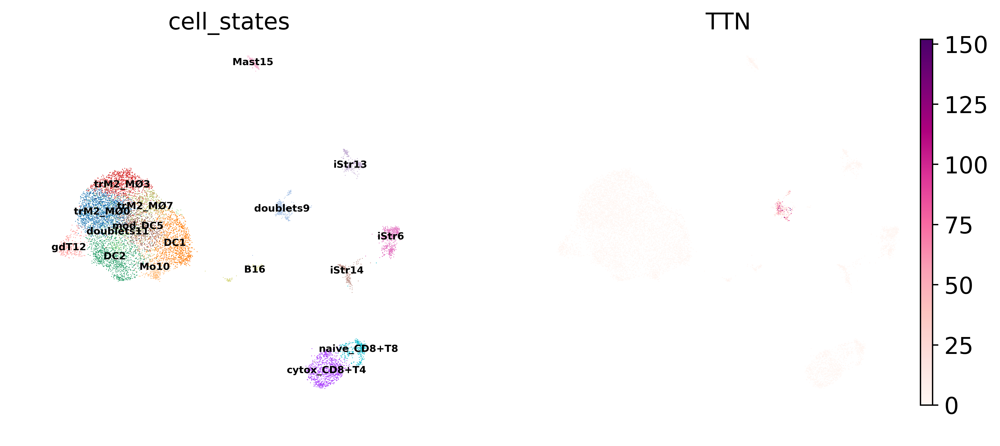

In [71]:
sc.pl.umap(sanger_bbknn_raw, color = ['cell_states', 'TTN'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False, use_raw = False)

- Harvard-Nuclei

In [72]:
#immune_harvard.X.astype(np.float64)
harvard_bckp = immune_harvard.copy()
sc.pp.normalize_per_cell(immune_harvard, counts_per_cell_after = 1e4)
sc.pp.log1p(immune_harvard)
immune_harvard.raw = immune_harvard

normalizing by total count per cell


Trying to set attribute `.obs` of view, copying.


    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [73]:
sc.pp.highly_variable_genes(immune_harvard, flavor = 'seurat')
harvard_hvg = immune_harvard[:, immune_harvard.var['highly_variable']]
sc.pp.scale(harvard_hvg, max_value = 10)
harvard_hvg.shape

extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/opt/conda/lib/python3.7/site-packages/scanpy/preprocessing/_simple.py:869: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


(13689, 5145)

In [74]:
sc.tl.pca(harvard_hvg, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(harvard_hvg, random_state = 1712)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:10)
computing neighbors
    using 'X_pca' with n_pcs = 50


/opt/conda/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../opt/conda/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:03)


In [75]:
harvard_hvg.obsm['X_pca_original'] = harvard_hvg.obsm['X_pca'].copy()
harvard_hvg.obsm['X_pca'] = regress_pca(harvard_hvg.obsm['X_pca'], harvard_hvg.obs['donor'])

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
	'distances', weighted adjacency matrix
	'connectivities', weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)
running Leiden clustering
    finished: found 23 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:06)


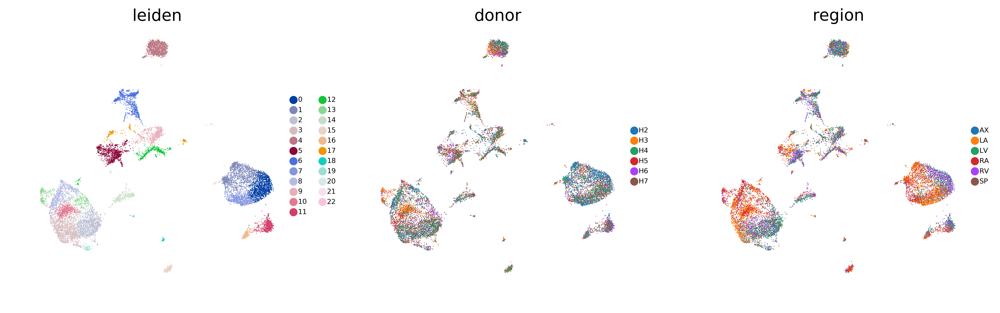

In [76]:
harvard_bbknn = bbknn.bbknn(harvard_hvg, neighbors_within_batch = 3, batch_key = 'donor', n_trees = 30, copy = True)
sc.tl.umap(harvard_bbknn, min_dist = 0.2, spread = 1, random_state = 1712)
sc.tl.leiden(harvard_bbknn, resolution = 1, random_state = 1786)
sc.pl.umap(harvard_bbknn, color = ['leiden', 'donor', 'region'], size = 2, legend_fontsize = 6, color_map = 'RdPu', frameon = False)

In [77]:
sc.tl.rank_genes_groups(harvard_bbknn, 'leiden', method = 'wilcoxon', n_genes = 200, use_raw = True)
result = harvard_bbknn.uns['rank_genes_groups']
groups = result['names'].dtype.names
markers_harvard = pd.DataFrame(
{group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals_adj', 'logfoldchanges']})
markers_harvard.head(10)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:41)


,0_n,0_p,0_l,1_n,1_p,1_l,2_n,2_p,2_l,3_n,...,19_l,20_n,20_p,20_l,21_n,21_p,21_l,22_n,22_p,22_l
0,PARP8,1.483998e-286,2.877645,IL7R,0.000000e+00,5.404735,CD163,2.651682e-134,2.434096,F13A1,...,3.392820,NRXN1,3.526067e-18,8.186441,LINC00299,4.395648e-13,6.631226,ARL15,5.412646e-12,5.040044
1,SKAP1,1.442458e-283,3.234653,ITK,3.834961e-262,3.575909,MRC1,5.855425e-128,2.478718,FRMD4B,...,2.767317,NRXN3,4.056577e-17,7.005105,AFF3,4.395648e-13,4.598665,PHKB,1.510686e-11,4.472170
2,THEMIS,3.329275e-256,4.121977,PDE3B,3.564637e-214,3.000533,FRMD4B,2.869836e-115,2.103441,RBPJ,...,6.278960,XKR4,2.534472e-15,7.646335,RUNX2,1.807823e-10,4.067375,CNST,2.021809e-11,5.471668
3,TC2N,1.968733e-250,3.406961,ANK3,6.277319e-211,3.244068,MS4A6A,1.467259e-109,2.358299,MRC1,...,2.335270,CADM2,5.574342e-15,6.446393,IL7R,6.872845e-08,3.919811,EPB41,3.944630e-11,5.000008
4,SLFN12L,8.407310e-164,3.166444,PARP8,2.016471e-206,2.509980,PLXDC2,5.190613e-104,1.959376,COLEC12,...,2.303605,CDH19,7.720291e-15,5.263936,PCDH9,2.331864e-06,4.069026,LTBP1,3.944630e-11,6.771162
5,PIP4K2A,7.820840e-158,1.841791,INPP4B,1.066747e-191,2.727826,F13A1,3.071623e-101,2.498477,MS4A6A,...,3.028616,ZNF536,1.860933e-13,6.684718,SAMD4A,7.920728e-06,3.188285,HERC1,9.829367e-11,4.796394
6,AC022075.1,1.683071e-157,3.238466,IKZF1,1.815551e-185,2.197718,FMN1,4.370575e-101,1.972598,MERTK,...,2.045197,SCN7A,7.290841e-12,4.017901,AREG,8.313577e-06,4.239805,ACRBP,9.933945e-11,9.465511
7,CD96,1.677635e-140,2.808464,PTPRC,5.142988e-184,2.035805,MERTK,2.714481e-100,2.134619,SLC9A9,...,1.736916,ANK3,1.583279e-10,3.284437,CD96,8.798538e-06,3.108810,TNIK,9.933945e-11,4.985489
8,CCND3,4.761344e-136,1.759136,ARHGAP15,1.730885e-179,1.792284,SLCO2B1,2.777493e-76,1.930397,LYVE1,...,2.034958,SHISA9,2.388041e-10,7.980589,HIPK2,2.857675e-05,2.683914,DNM3,2.821051e-10,7.122759
9,CBLB,3.782435e-132,1.773319,FYN,7.409245e-179,2.568696,RBPJ,1.837410e-73,1.848511,RBM47,...,1.938963,ADGRB3,6.066040e-10,4.070913,SYTL3,4.153426e-05,2.531620,ABCC4,6.341429e-10,6.213176


In [78]:
markers_harvard.to_csv('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_immune_harvard-nuclei_wilcox_ctl200518.tsv', sep = '\t', index = False)

In [79]:
harvard_bbknn.obs['leiden'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22'],
      dtype='object')

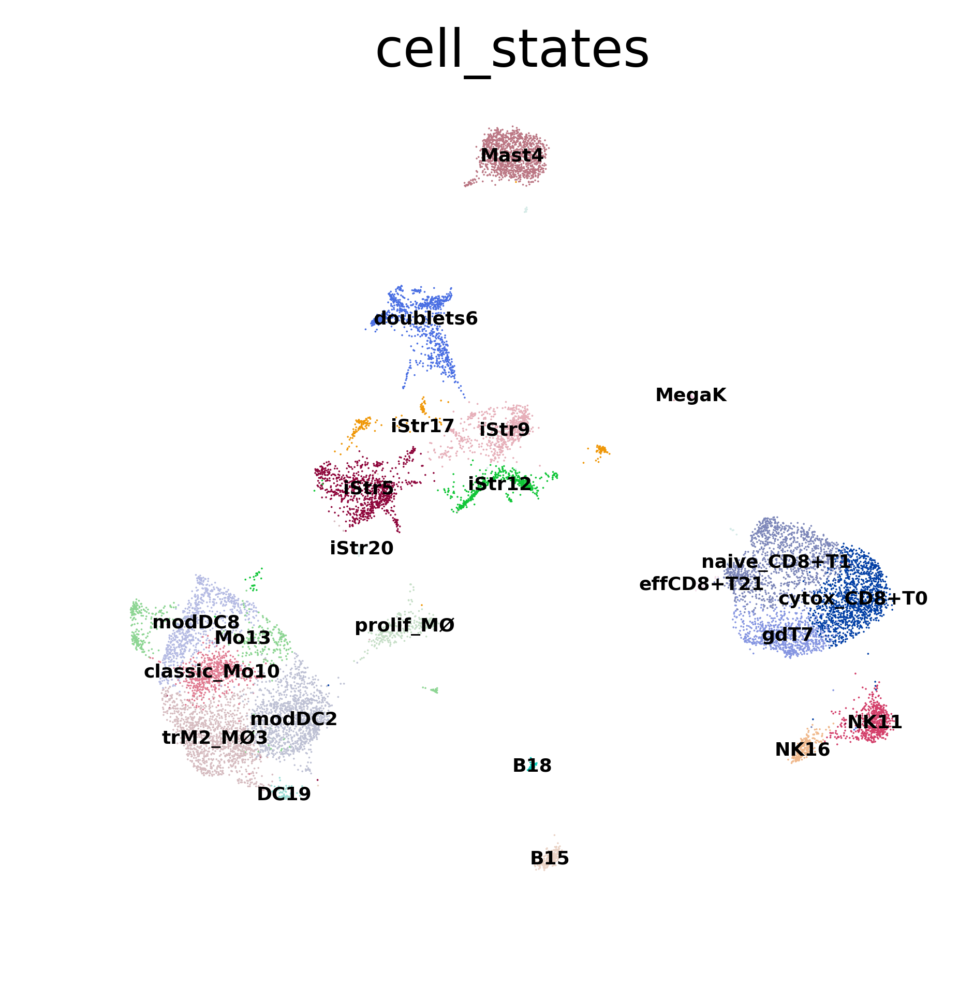

In [83]:
harvard_bbknn.obs['cell_states'] = harvard_bbknn.obs['leiden']
harvard_bbknn.obs['cell_states'].cat.categories = ['cytox_CD8+T0', 'naive_CD8+T1', 'modDC2', 'trM2_MØ3', 'Mast4', 'iStr5', 'doublets6', 'gdT7', 'modDC8', 'iStr9', 'classic_Mo10', 'NK11', 'iStr12',
       'Mo13', 'prolif_MØ', 'B15', 'NK16', 'iStr17', 'B18', 'DC19', 'iStr20', 'effCD8+T21', 'MegaK']
sc.pl.umap(harvard_bbknn, color = ['cell_states'], size = 1, legend_fontsize = 5, legend_loc = 'on data', frameon = False)

In [84]:
harvard_bbknn_raw = anndata.AnnData(X = harvard_bckp.X , obs = harvard_bbknn.obs, var = harvard_bckp.var, obsm = harvard_bbknn.obsm)
harvard_bbknn_raw.write('/home/jovyan/cartal_experiments/subpopulations/4-immune/1-annotated_sources/heart_harvard_immmune_nuclei_annotated_ctl200518.h5ad')

In [85]:
harvard_bbknn_raw.obs['cell_states'].cat.categories

Index(['cytox_CD8+T0', 'naive_CD8+T1', 'modDC2', 'trM2_MØ3', 'Mast4', 'iStr5',
       'doublets6', 'gdT7', 'modDC8', 'iStr9', 'classic_Mo10', 'NK11',
       'iStr12', 'Mo13', 'prolif_MØ', 'B15', 'NK16', 'iStr17', 'B18', 'DC19',
       'iStr20', 'effCD8+T21', 'MegaK'],
      dtype='object')

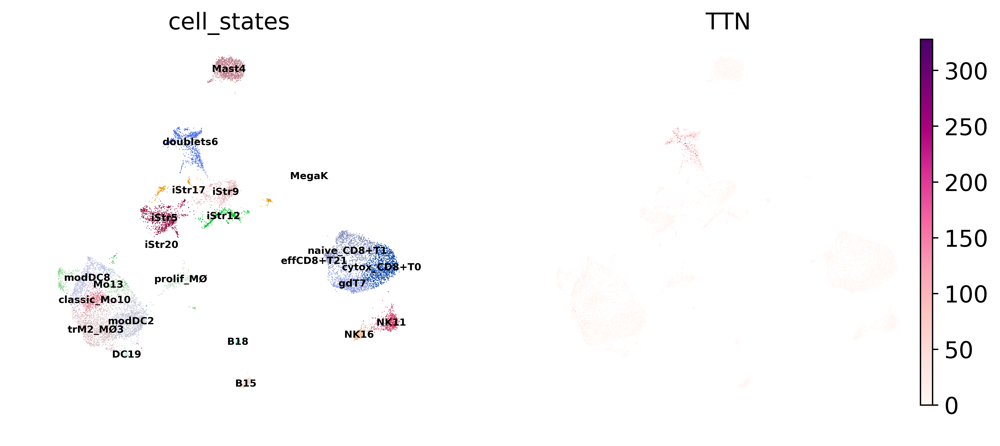

In [86]:
sc.pl.umap(harvard_bbknn_raw, color = ['cell_states', 'TTN'], size = 1, legend_fontsize = 6, legend_loc = 'on data', frameon = False, use_raw = False)